Reduce the Number of Intensity Levels in an Image

Saving wildlife-9653797_1920.jpg to wildlife-9653797_1920 (1).jpg
wildlife-9653797_1920 (1).jpg
Original image:


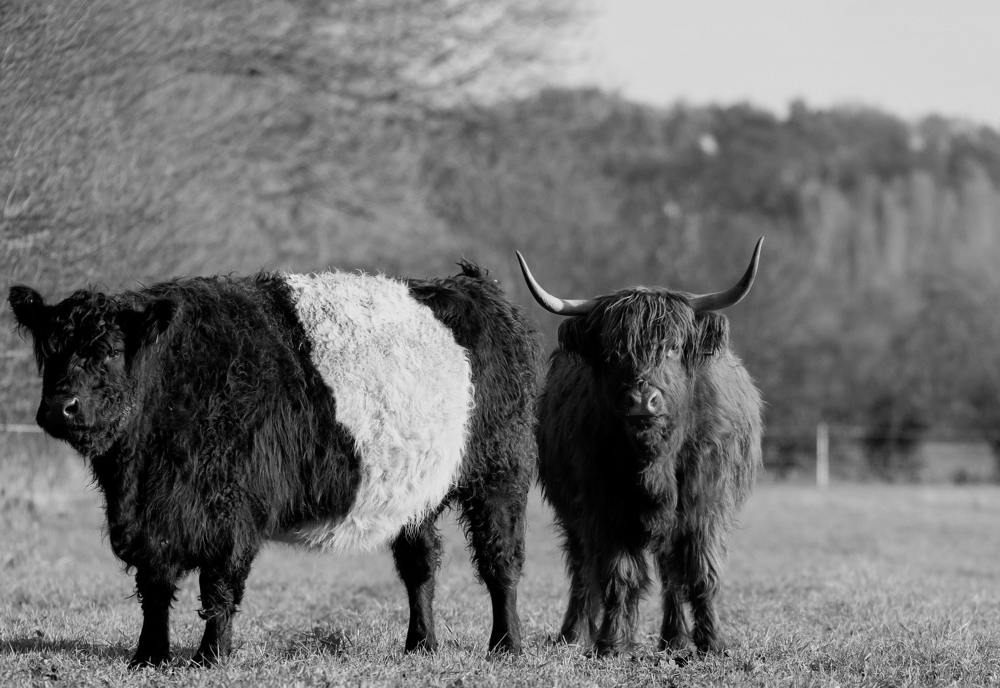

image of reduced intensity 2 levels :


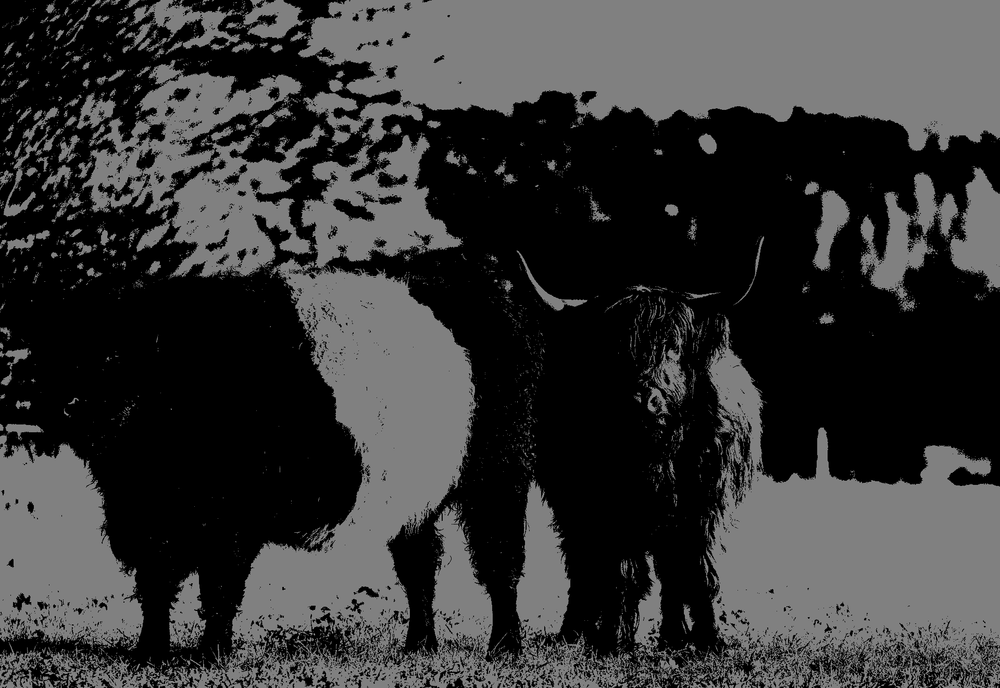

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

image of reduced intensity 4 levels :


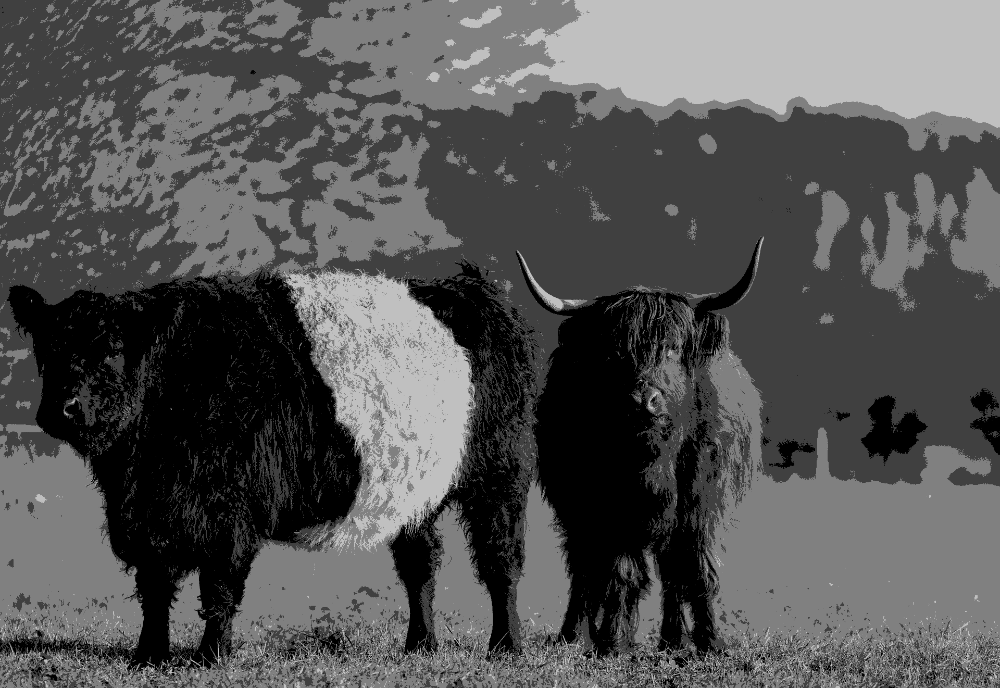

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

image of reduced intensity 16 levels :


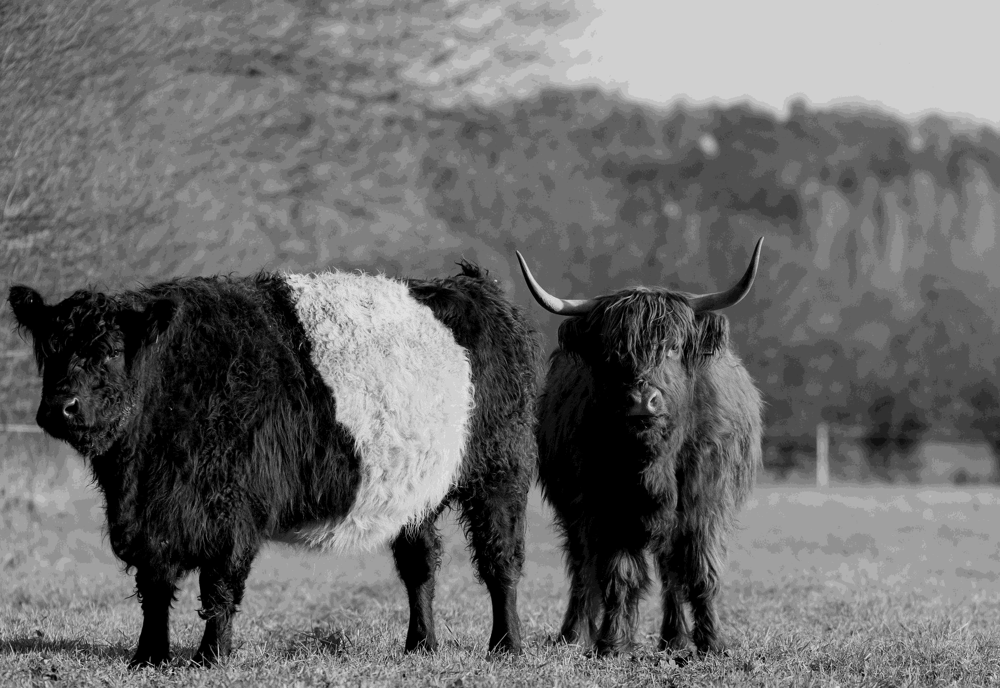

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [2]:
# Step 1: Upload your image
from google.colab import files
uploaded = files.upload()  # Click "Choose Files" and select your image

# Step 2: Import libraries
import cv2
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt

# Step 3: Get the uploaded filename
filename = next(iter(uploaded))

# Step 4: Read and display the original image (grayscale)
print(filename)
img = cv2.imread(filename, cv2.IMREAD_GRAYSCALE)
print("Original image:")
cv2_imshow(img)  # or use plt.imshow(img, cmap='gray')

# Step 5: Reduce intensity levels
def reduce_intensity_levels(img, levels):
    factor = 256 // levels
    reduced_img = (img // factor) * factor
    return reduced_img

reduced_img = reduce_intensity_levels(img, 2)

# Step 6: Display the reduced image
print("image of reduced intensity 2 levels :")
cv2_imshow(reduced_img)  # or use plt.imshow(reduced_img, cmap='gray')

# Step 7: Save and download the result
output_filename = 'reduced_2_levels.jpg'
cv2.imwrite(output_filename, reduced_img)
files.download(output_filename)

reduced_img = reduce_intensity_levels(img, 4)

# Step 6: Display the reduced image
print("image of reduced intensity 4 levels :")
cv2_imshow(reduced_img)  # or use plt.imshow(reduced_img, cmap='gray')

# Step 7: Save and download the result
output_filename = 'reduced_4_levels.jpg'
cv2.imwrite(output_filename, reduced_img)
files.download(output_filename)

reduced_img = reduce_intensity_levels(img, 16)

# Step 6: Display the reduced image
print("image of reduced intensity 16 levels :")
cv2_imshow(reduced_img)  # or use plt.imshow(reduced_img, cmap='gray')

# Step 7: Save and download the result
output_filename = 'reduced_16_levels.jpg'
cv2.imwrite(output_filename, reduced_img)
files.download(output_filename)


Spatial Averaging (Mean Filter) with 3x3, 10x10, and 20x20 Neighborhoods

wildlife-9653797_1920 (1).jpg
Original image:


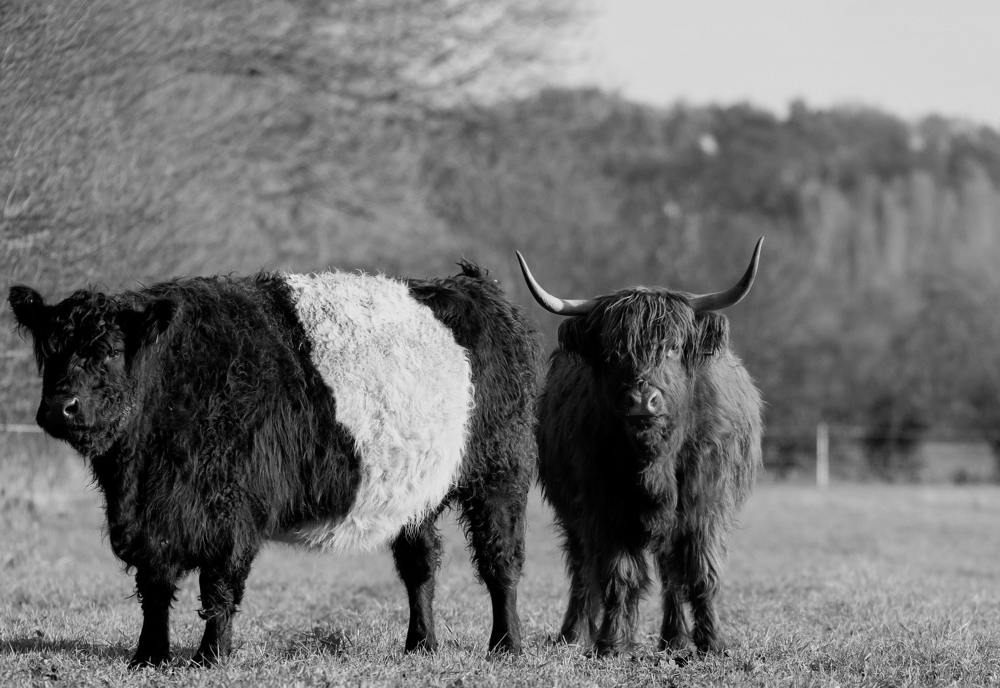

3x3 Mean Filtered Image:


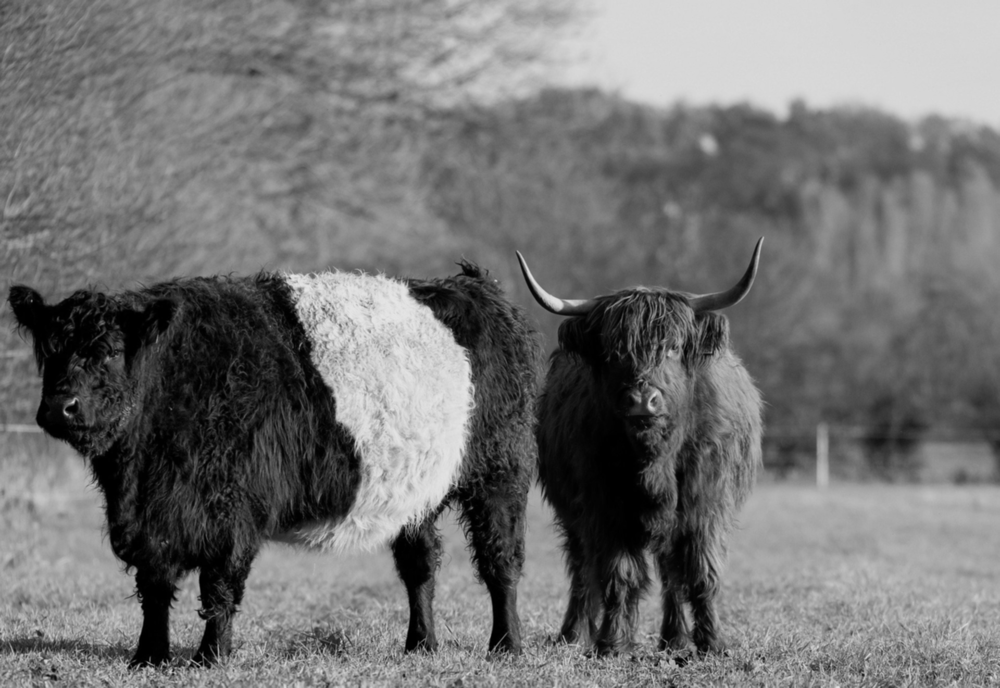

10x10 Mean Filtered Image:


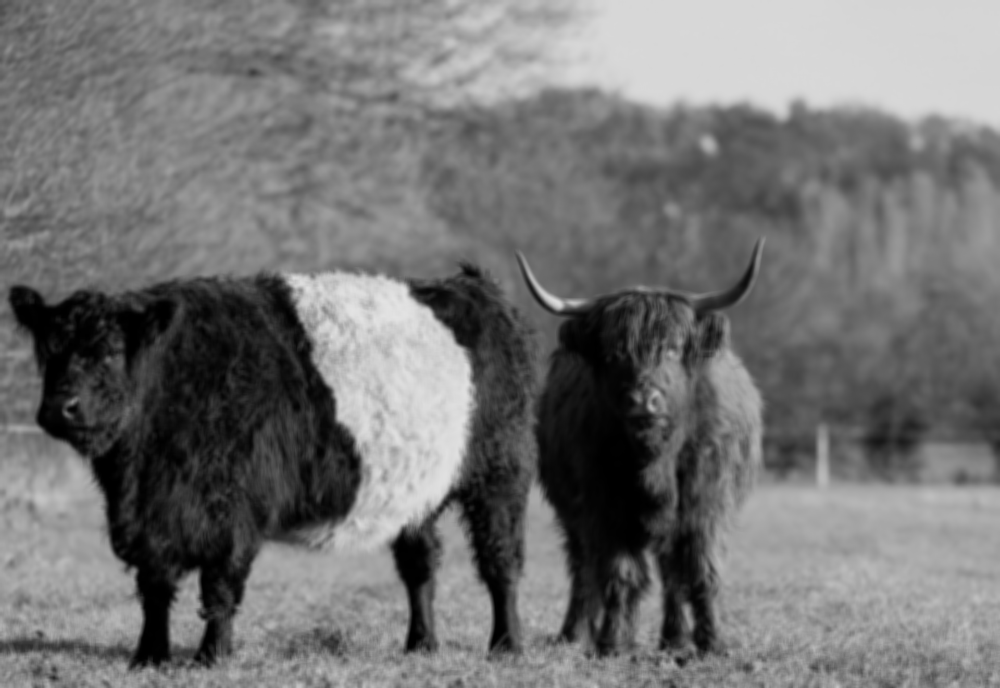

20x20 Mean Filtered Image:


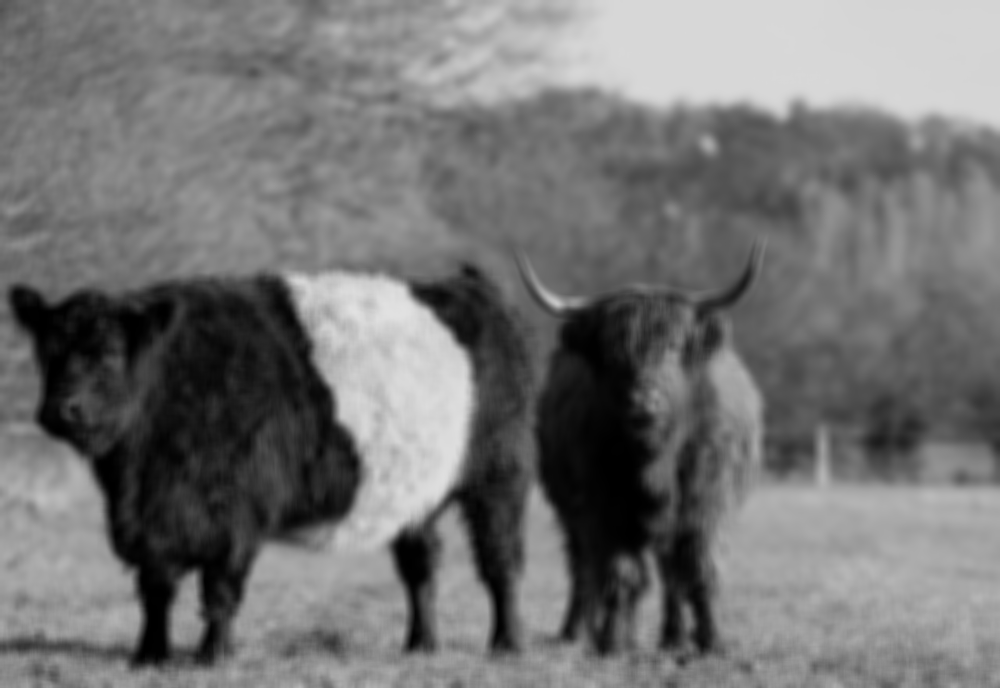

True

In [4]:
img = cv2.imread(filename, cv2.IMREAD_GRAYSCALE)
print("Original image:")
cv2_imshow(img)

# Apply mean filters of different sizes
def mean_filter(img, ksize):
    return cv2.blur(img, (ksize, ksize))

blur_3x3 = mean_filter(img, 3)
blur_10x10 = mean_filter(img, 10)
blur_20x20 = mean_filter(img, 20)

# Display the results
print("3x3 Mean Filtered Image:")
cv2_imshow(blur_3x3)

print("10x10 Mean Filtered Image:")
cv2_imshow(blur_10x10)

print("20x20 Mean Filtered Image:")
cv2_imshow(blur_20x20)

# Optionally, save the results
cv2.imwrite('blur_3x3.jpg', blur_3x3)
cv2.imwrite('blur_10x10.jpg', blur_10x10)
cv2.imwrite('blur_20x20.jpg', blur_20x20)


Rotate Image by 45 and 90 Degrees

Original image:


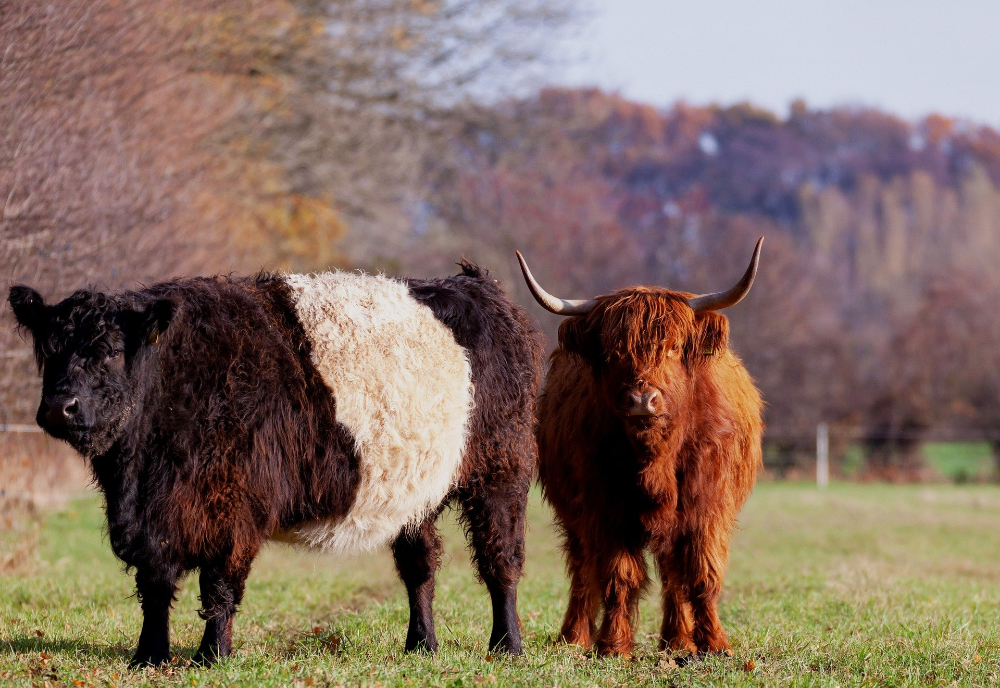

Rotated by 45 degrees:


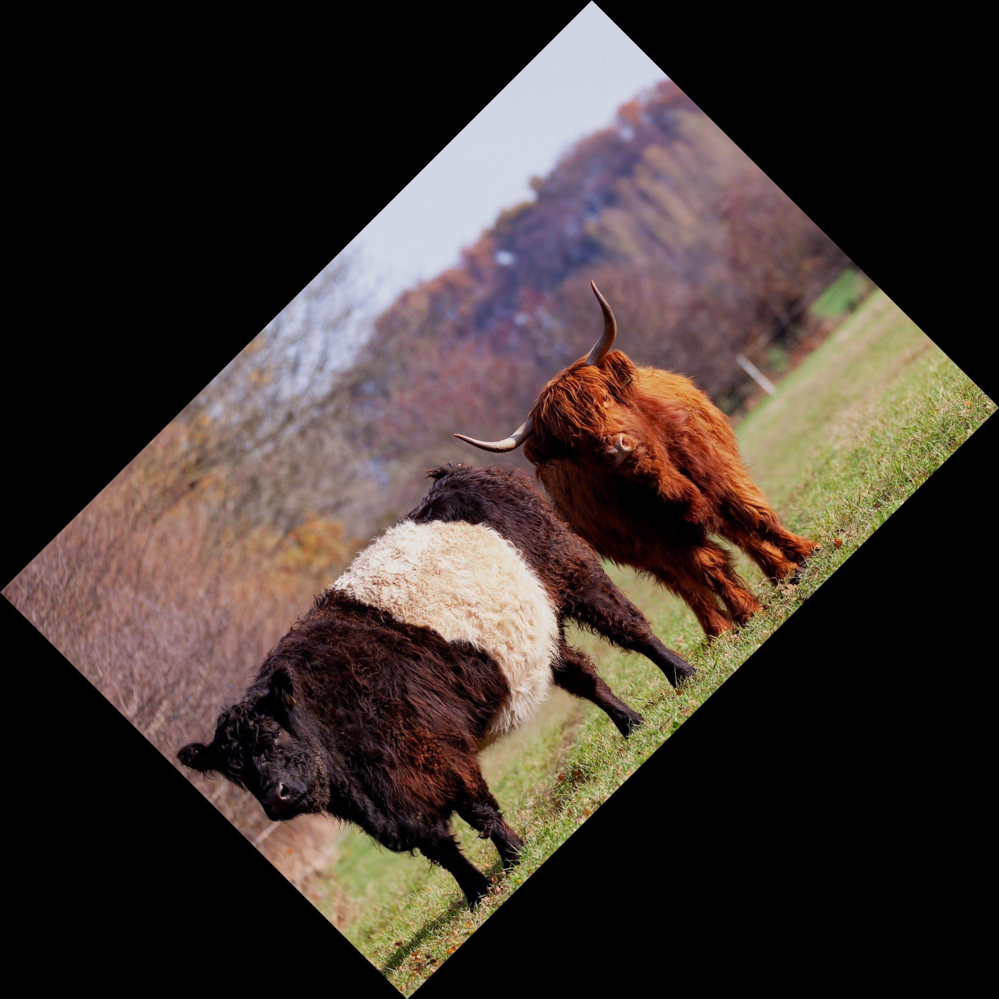

Rotated by 90 degrees:


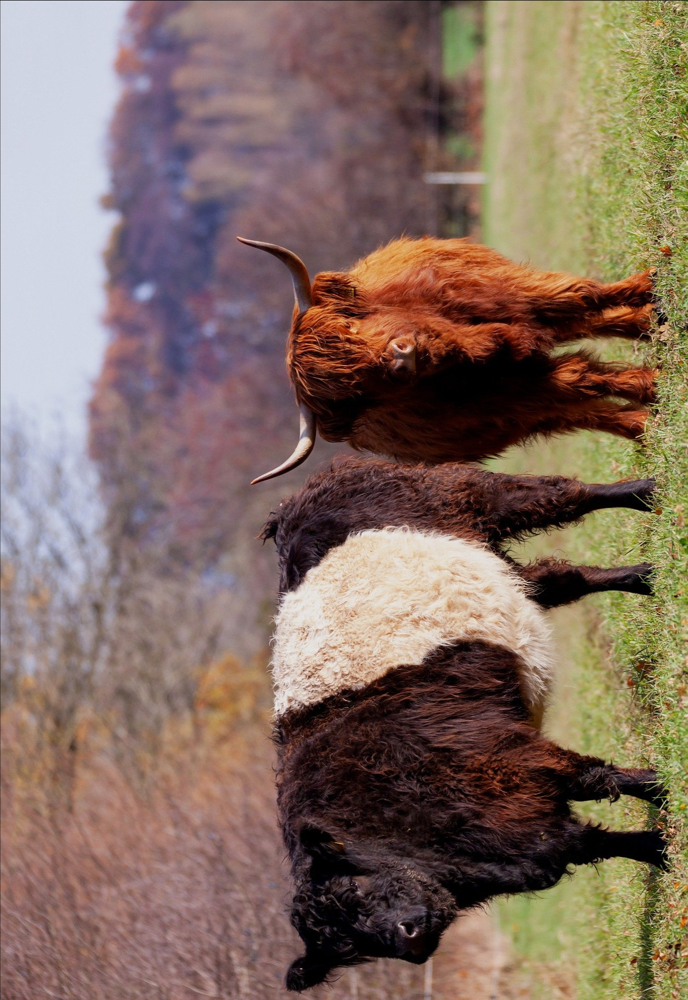

True

In [3]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np

# Use the same filename as before
#filename = '1.jpg'  # Replace with your actual filename if different

# Read the image (color image for better visualization)
img = cv2.imread(filename)

print("Original image:")
cv2_imshow(img)

def rotate_image(image, angle):
    (h, w) = image.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    # For 45 degrees, the output size may need to be larger to avoid cropping
    if angle % 180 != 0:
        # Compute the new bounding dimensions
        cos = np.abs(M[0, 0])
        sin = np.abs(M[0, 1])
        new_w = int((h * sin) + (w * cos))
        new_h = int((h * cos) + (w * sin))
        # Adjust the rotation matrix to consider the translation
        M[0, 2] += (new_w / 2) - center[0]
        M[1, 2] += (new_h / 2) - center[1]
        rotated = cv2.warpAffine(image, M, (new_w, new_h))
    else:
        rotated = cv2.warpAffine(image, M, (w, h))
    return rotated

# Rotate by 45 degrees
rotated_45 = rotate_image(img, 45)
print("Rotated by 45 degrees:")
cv2_imshow(rotated_45)
cv2.imwrite('rotated_45.jpg', rotated_45)

# Rotate by 90 degrees
rotated_90 = rotate_image(img, 90)
print("Rotated by 90 degrees:")
cv2_imshow(rotated_90)
cv2.imwrite('rotated_90.jpg', rotated_90)


Block-wise Averaging to Simulate Spatial Resolution Reduction

Original image:


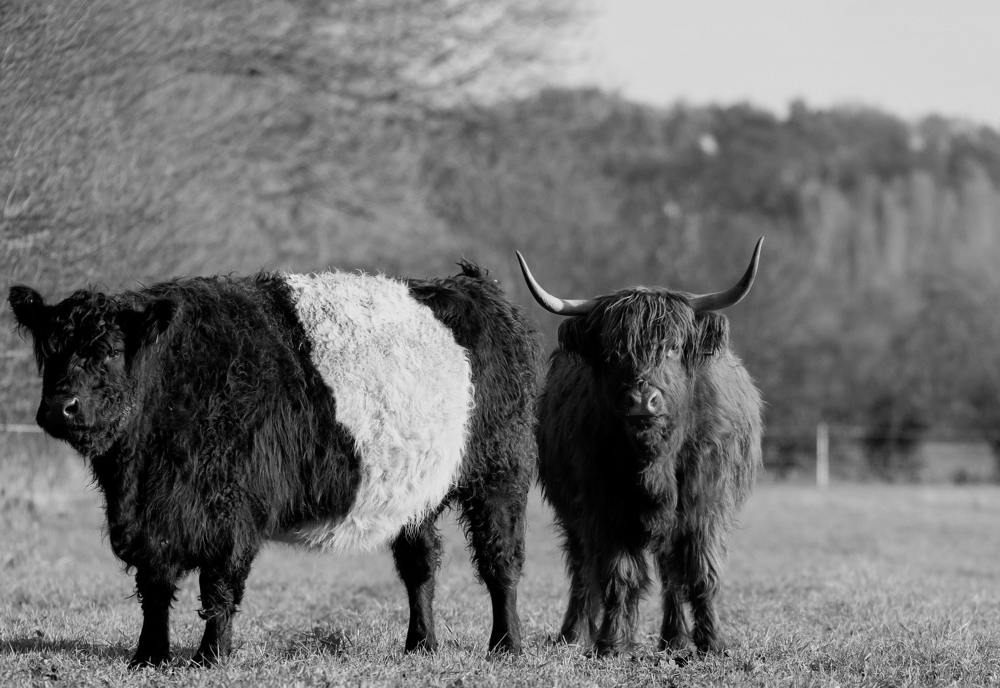

Block-wise average (3x3):


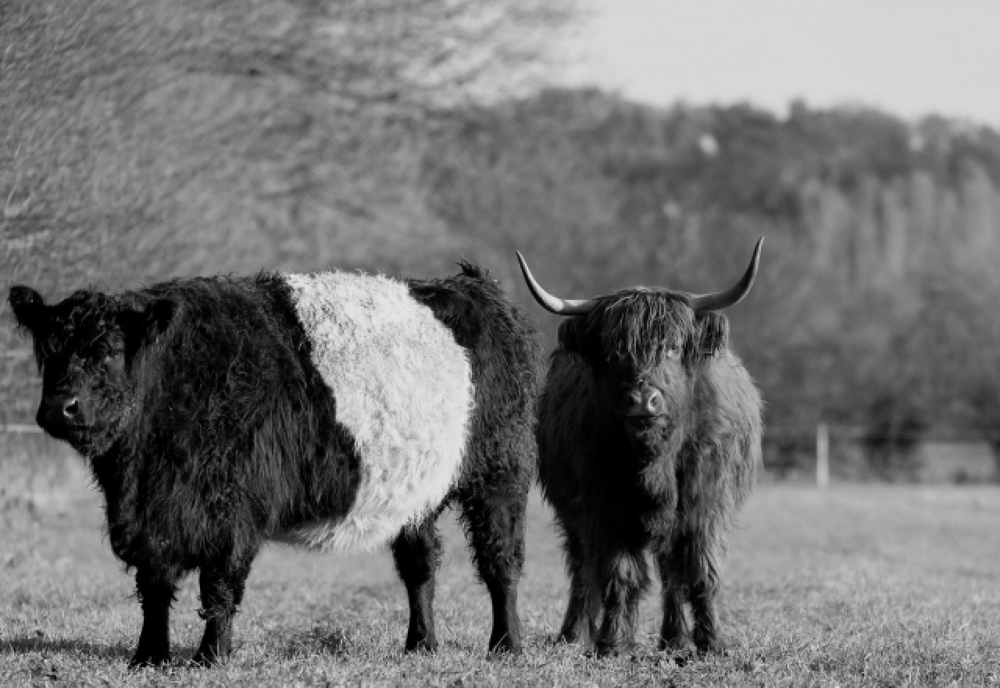

Block-wise average (5x5):


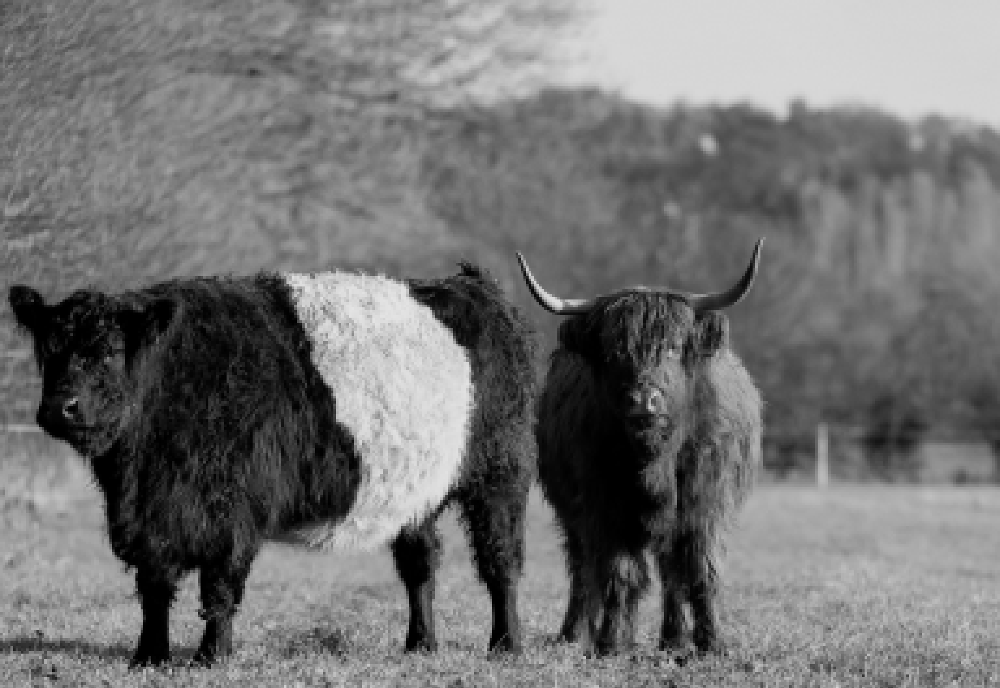

Block-wise average (7x7):


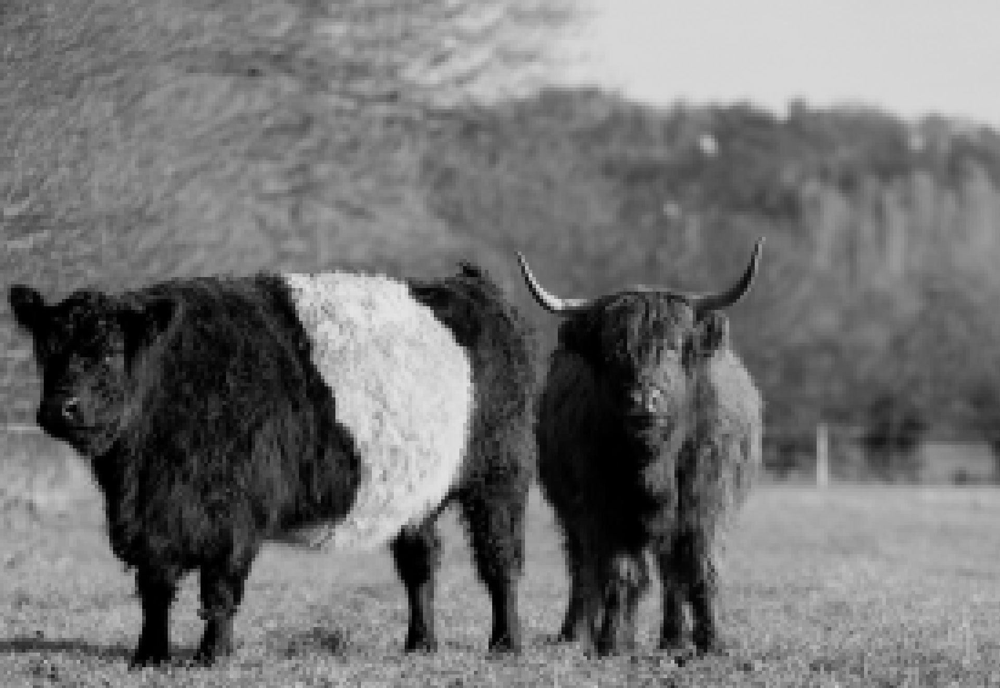

True

In [14]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# Use the same filename as before
#filename = '1.jpg'  # Replace with your actual filename if different

# Read the image in grayscale
img = cv2.imread(filename, cv2.IMREAD_GRAYSCALE)
print("Original image:")
cv2_imshow(img)

def blockwise_average(img, block_size):
    h, w = img.shape
    out = img.copy()
    for i in range(0, h, block_size):
        for j in range(0, w, block_size):
            block = img[i:i+block_size, j:j+block_size]
            avg = np.mean(block, dtype=np.float32)
            out[i:i+block_size, j:j+block_size] = avg
    return out.astype(np.uint8)

# Apply block-wise averaging
block_3x3 = blockwise_average(img, 3)
block_5x5 = blockwise_average(img, 5)
block_7x7 = blockwise_average(img, 7)

# Display the results
print("Block-wise average (3x3):")
cv2_imshow(block_3x3)
print("Block-wise average (5x5):")
cv2_imshow(block_5x5)
print("Block-wise average (7x7):")
cv2_imshow(block_7x7)

# Save the results
cv2.imwrite('block_3x3.jpg', block_3x3)
cv2.imwrite('block_5x5.jpg', block_5x5)
cv2.imwrite('block_7x7.jpg', block_7x7)
